# Import libraries and define utility functions

In [1]:
from dateutil import tz
from datetime import datetime
import json
import pandas as pd
from gps_utils import find_closest_index, distance, to_date
import numpy as np
import bamboolib as bam
from tqdm.notebook import tqdm
tqdm.pandas()

In [2]:
def to_datetime(timestamp):
    """
    Convert timestamp to datetime
    """
    datetime_timestamp = datetime.strptime(
        timestamp.rsplit(':', 1)[0], "%Y-%m-%dT%H:%M")
    return datetime_timestamp

def image_to_datetime(minute_id, image_id):
    utc_time = datetime.strptime(minute_id+"00", "%Y%m%d_%H%M%S")
    minute = int(image_id[11:13])
    second = int(image_id[13:15])
    image_time = utc_time.replace(minute=minute, second=second)
    return image_time

def find_closest_image(timestamp):
    #convert to datetime
    datetime_timestamp = datetime.strptime(
        timestamp.rsplit(':', 1)[0], "%Y-%m-%dT%H:%M")
    # find images
    i = find_closest_index(all_image_times, datetime_timestamp)
    return metadata.loc[i, "ImageID"]

# Processing Ground Truth

In [306]:
google_maps = json.load(open("../../original_data/2019_JANUARY.json"))
metadata = pd.read_csv('../files/processed.csv', sep=',', decimal='.', nrows=100000)
all_image_times = [image_to_datetime(minute_id, image_id) for (minute_id, image_id) in zip(metadata["minute_id"], metadata["ImageID"])]
all_image_ids = list(metadata["ImageID"])

In [307]:
segment_rows = []
for segment in google_maps['timelineObjects']:
    if 'placeVisit' in segment:
        segment = segment['placeVisit']
        segment_rows.append({"stop": True,
                             "checkin": segment['location']['name'],
                             "first": segment['duration']['startTimestamp'],
                             "last": segment['duration']['endTimestamp'],
                             "lat": segment['location']["latitudeE7"] * 1e-7,
                             "lon": segment['location']["longitudeE7"] * 1e-7,
                             "end_latitude": "",
                             "end_longitude": "",
                             "points": []})
    else:
        segment = segment['activitySegment']
        points = []
        if "simplifiedRawPath" in segment:
            points = segment["simplifiedRawPath"]["points"]
        else:
            points = segment["waypointPath"]["waypoints"]
        segment_rows.append({"stop": False,
                             "checkin": segment['activityType'],
                             "first": segment['duration']['startTimestamp'],
                             "last": segment['duration']['endTimestamp'],
                             "lat": segment['startLocation']["latitudeE7"] * 1e-7,
                             "lon": segment['startLocation']["longitudeE7"] * 1e-7,
                             "end_latitude": segment['endLocation']["latitudeE7"] * 1e-7,
                             "end_longitude": segment['endLocation']["longitudeE7"] * 1e-7,
                             "points": points})

segment_df = pd.DataFrame.from_dict(segment_rows)

In [308]:
segment_df = segment_df[['stop', 'checkin', 'first', 'last', 'lat', 'lon', 'end_latitude', 'end_longitude', 'points']]
segment_df['duration'] = segment_df['last'].apply(to_datetime) - segment_df['first'].apply(to_datetime)
segment_df['duration'] = segment_df['duration'].apply(lambda x: x.seconds) / 60
segment_df["first"] = [find_closest_image(
    timestamp) for timestamp in segment_df["first"]]
segment_df["last"] = [find_closest_image(
    timestamp) for timestamp in segment_df["last"]]

In [309]:
from datetime import datetime, timezone, timedelta
# Language libraries
from unidecode import unidecode
from googletrans import Translator, constants
from langdetect import detect
import re
# Translating
translator = Translator()
text_exceptions={"Adapt Centre @ Dcu": "Adapt Centre @ Dcu",
                "777": "777",
                "Nip@tuck": "Nip@tuck"}
def to_english(text, debug=False):
    if text:
        if text in text_exceptions:
            return text_exceptions[text]
        try:
            lang = detect(text)
            if lang != "en":
                text = translator.translate(text).text
            return unidecode(text)
        except Exception as e:
            if debug:
                print(f"Error translating \"{text}\"")
                raise(e)
            else:
                pass
    return text

In [7]:
segment_df['checkin'] = segment_df['checkin'].progress_apply(to_english)

  0%|          | 0/420 [00:00<?, ?it/s]

KeyboardInterrupt: 

<AxesSubplot:xlabel='Day', ylabel='Number of events'>

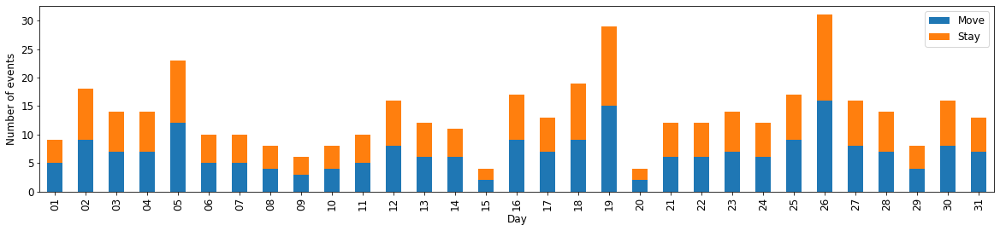

In [310]:
segment_df['date'] = segment_df['first'].apply(lambda x: x.split("_")[0])
plot_kwargs={
             'xlabel': "Day",
             "ylabel": "Number of events",
             'fontsize':12,
             'figsize': (20, 4)}
to_plot = segment_df.groupby('date')['stop'].value_counts().unstack()
to_plot = to_plot.reset_index()
to_plot.columns = ["Day", "Move", "Stay"]
to_plot["Day"] = to_plot["Day"].apply(lambda x: x[-2:])
to_plot = to_plot.set_index("Day")
to_plot.plot.bar(stacked=True, **plot_kwargs)

In [49]:
segment_df.to_csv('files/test/segment_df.csv')

In [8]:
segment_df = pd.read_csv('files/segment_df.csv')

# VAILS results

In [218]:
stops = pd.read_csv('files/test/final_pure.csv', sep=',', decimal='.', nrows=100000)

In [93]:
stops["stop"].value_counts()

True     294
False    159
Name: stop, dtype: int64

In [95]:
stops.loc[stops['checkin'].isin(['Walking Inside', 'Walking Outside']), 'checkin'] = 'WALKING'
# stops.loc[stops['movement'].isin(['Still', 'Private Home']), 'stop'] = True
stops.loc[stops['checkin'].isin(['Car', 'Public Transport', 'Parking Lot']), 'checkin'] = 'IN_PASSENGER_VEHICLE'
stops.loc[stops['checkin'].isin(['Airplane']), 'checkin'] = 'FLYING'
stops

     Unnamed: 0  new_name   stop                checkin    categories parent  \
0             0         1   True                   HOME           NaN    NaN   
1             1         2  False   IN_PASSENGER_VEHICLE           NaN    NaN   
2             2         3   True  Charm Hand & Foot Spa           NaN    NaN   
3             3         4  False   IN_PASSENGER_VEHICLE           NaN    NaN   
4             4         5   True                TOP Oil  Fuel Station    NaN   
..          ...       ...    ...                    ...           ...    ...   
448         448       449   True  Charm Hand & Foot Spa           NaN    NaN   
449         449       450  False   IN_PASSENGER_VEHICLE           NaN    NaN   
450         450       451   True           The Kilbronx           NaN    NaN   
451         451       452  False   IN_PASSENGER_VEHICLE           NaN    NaN   
452         452       453   True                   HOME           NaN    NaN   

           lat       lon               

# Clustering Evaluation

## Number of stops/moves
214 trips - 201 trips  
206 stops - 178 stops

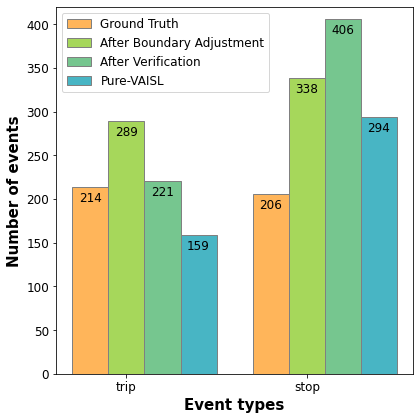

In [87]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns 

font = {'size': 12}

matplotlib.rc('font', **font)

# set width of bar
barWidth = 0.2
fig = plt.subplots(figsize =(6, 6))
 
# set height of bar
GTs = [214, 206]
preVerify = [289, 338]
preVAISL = [221, 406]
pureVAISL = [159, 294]
 
# Set position of bar on X axis
br1 = np.arange(len(preVerify))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]


# Make the plot
bar1 = plt.bar(br1, GTs, color = "#ffb55a", width = barWidth,
        edgecolor ='grey', label ='Ground Truth')
bar2 = plt.bar(br2, preVerify, color = "#a6d75b", width = barWidth,
        edgecolor ='grey', label ='After Boundary Adjustment')
bar3 = plt.bar(br3, preVAISL, color = "#76c68f", width = barWidth,
        edgecolor ='grey', label ='After Verification')
bar4 = plt.bar(br4, pureVAISL, color = "#48b5c4", width = barWidth,
        edgecolor ='grey', label ='Pure-VAISL')
 
# Adding Xticks
plt.xlabel('Event types', fontweight ='bold', fontsize = 15)
plt.ylabel('Number of events', fontweight ='bold', fontsize = 15)
plt.xticks([r + barWidth for r in range(len(preVerify))],
        ['trip', 'stop'])
plt.ylim([0, 420])

# Add counts above the two bar graphs
for rect in bar1 + bar2 + bar3 + bar4:
    height = rect.get_height()
    plt.text(rect.get_x() + rect.get_width() / 2.0, height - 20, f'{height:.0f}', ha='center', va='bottom')

plt.legend()
plt.tight_layout()
plt.show()

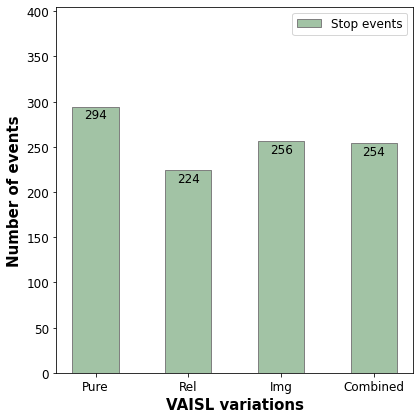

In [217]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns 

font = {'size': 12}

matplotlib.rc('font', **font)

# set width of bar
barWidth = 0.5
fig = plt.subplots(figsize =(6, 6))
 
# set height of bar
stops = [294, 224, 256, 254]
 
# Set position of bar on X axis
br1 = np.arange(len(stops))

# Make the plot
bar1 = plt.bar(br1, stops, color ="#a2c3a5", width = barWidth,
        edgecolor ='grey', label ='Stop events')
 
# Adding Xticks
plt.xlabel('VAISL variations', fontweight ='bold', fontsize = 15)
plt.ylabel('Number of events', fontweight ='bold', fontsize = 15)
plt.xticks([r for r in range(len(stops))],
        ['Pure', 'Rel', 'Img', 'Combined'])
plt.ylim([0, 405])

# Add counts above the two bar graphs
for rect in bar1:
    height = rect.get_height()
    plt.text(rect.get_x() + rect.get_width() / 2.0, height - 16, f'{height:.0f}', ha='center', va='bottom')

plt.legend()
plt.tight_layout()
plt.show()

## Accuracy stop/move

In [97]:
stops["first"] = [str(images).split(',')[0].strip("'[] ") for images in stops["images"]]
stops["last"] = [str(images).split(',')[-1].strip("'[] ") for images in stops["images"]]
metadata['stop'] = [False for i in range(len(metadata))]
metadata['name'] = ["" for i in range(len(metadata))]

for i, row in tqdm(stops.iterrows(), total=len(stops)):
    rows_to_change = range(all_image_ids.index(row["first"]), all_image_ids.index(row["last"]) + 1)
    metadata.loc[rows_to_change, "stop"] = row["stop"]
    metadata.loc[rows_to_change, "name"] = row["checkin"]

  0%|          | 0/453 [00:00<?, ?it/s]

In [40]:
metadata['stop_GT'] = [False for i in range(len(metadata))]
metadata['name_GT'] = ["" for i in range(len(metadata))]

for i, row in tqdm(segment_df.iterrows(), total=len(segment_df)):
    rows_to_change = range(all_image_ids.index(row["first"]), all_image_ids.index(row["last"]))
    metadata.loc[rows_to_change, "stop_GT"] = row["stop"]
    # metadata.loc[rows_to_change, "name_GT"] = row["checkin"]

  0%|          | 0/420 [00:00<?, ?it/s]

In [41]:
confusion_matrix = pd.crosstab(metadata['stop_GT'], metadata['stop'], rownames=['Actual'], colnames=['Predicted'])
print(confusion_matrix)

Predicted  False   True
Actual                 
False       3611    718
True         717  37594


In [42]:
from sklearn.metrics import cohen_kappa_score, accuracy_score
accuracy_score(metadata['stop_GT'], metadata['stop'])

0.9663461538461539

In [43]:
cohen_kappa_score(metadata['stop_GT'], metadata['stop'])

0.8155101308722559

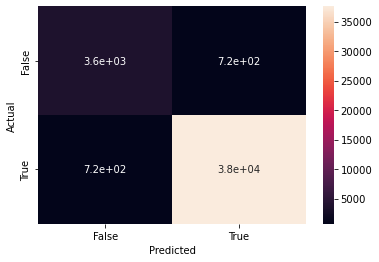

In [44]:
import seaborn as sn
import matplotlib.pyplot as plt

sn.heatmap(confusion_matrix, annot=True)
plt.show()

# Match stops with groundtruth
Calculating IOU (Intersection over Union). The higher IOU score is, the better.  
iou = 0.5822692773019205

In [274]:
ground_truth_times = [(row["first"], row["last"], row["checkin"], row["stop"]) for (i, row) in segment_df.iterrows()]

In [381]:
all_images = list(metadata["ImageID"])
def calculate_iou(start, end, gt_start, gt_end):
    if gt_start > end or gt_end < start:
        return 0
    start, end, gt_start, gt_end = [all_images.index(i) for i in [start, end, gt_start, gt_end]]
    intersection = max(0, min(end, gt_end) - max(start, gt_start) + 1)
    union = end - start + 1 + gt_end - gt_start + 1 - intersection
    return intersection/union

def get_all_iou(starts, ends, stops):
    # iou = 0
    indices = []
    ious = []
    names = []
    match_stops = []
    for start, end, is_stop in zip(starts, ends, stops):
        # if is_stop:
        current_ious = [calculate_iou(start, end, gt_start, gt_end) for gt_start, gt_end, *_ in ground_truth_times]
        i = np.argmax(current_ious)
        ious.append(current_ious[i])
        if current_ious[i] > 0:
            indices.append(i)
            names.append(ground_truth_times[i][2])
            match_stops.append(ground_truth_times[i][3])
        else:
            indices.append(-1)
            names.append("")
            match_stops.append(None)
            
    return ious, indices, names, match_stops

ious, indices, names, match_stops = get_all_iou(stops['first'], stops['last'], stops['stop'])
stops['best_match'] = indices
stops['match_with_stop'] = match_stops
stops['iou'] = ious
stops['best_name'] = names

In [382]:
stops = stops[['iou', 'best_match', 'best_name', 'match_with_stop',
               'checkin'] + ['stop', 'lat', 'lon', 'all_lon', 'all_lat', 'images', 'first', 'last']]

# Event characterisation Evaluation

## Stops

In [380]:
stops = pd.read_csv('files/test/final_pure.csv', sep=',', decimal='.', nrows=100000)

In [329]:
stops = segment_df

## One day

In [237]:
stops_only = stops.loc[~(stops['stop'] == False)]
# stops_only.to_csv('files/iou_comb.csv')

In [238]:
stops.loc[stops['first'].str.startswith('20190126', na=False) | stops['last'].str.startswith('20190126', na=False)]['stop'].value_counts()

True     17
False    15
Name: stop, dtype: int64

In [239]:
test = stops_only.loc[stops_only['first'].str.startswith('20190126', na=False) | stops_only['last'].str.startswith('20190126', na=False)]
test

     Unnamed: 0  new_name  stop                       checkin  \
320         320       321  True                          HOME   
322         322       323  True         Charm Hand & Foot Spa   
324         324       325  True         Charm Hand & Foot Spa   
326         326       327  True                          HOME   
328         328       329  True         Charm Hand & Foot Spa   
330         330       331  True       Cois Bá Family Practice   
332         332       333  True          Omni Shopping Centre   
334         334       335  True         Charm Hand & Foot Spa   
336         336       337  True                          HOME   
338         338       339  True         Charm Hand & Foot Spa   
340         340       341  True      Homebase - Dublin Santry   
342         342       343  True          Musgrave Marketplace   
344         344       345  True  Dublin City University (DCU)   
345         345       346  True         Charm Hand & Foot Spa   
347         347       348

In [ ]:
num_stop = [17, 17, 17, 20]
num_all = [32, 32, 32, 37]
acc = [16, 16, 14, 15]

# REL: Centra -> LLoyds (next door)

## All days

In [383]:
stops_only = stops.loc[~(stops['stop'] == False)]
stops_only = stops_only.loc[~(stops_only['checkin'].isin(['HOME', 'Charm Hand & Foot Spa']))]
stops_only = stops_only.loc[~(stops_only['checkin'].str.contains('DCU', case=False, regex=False, na=False))]
stops_only = stops_only.drop(columns=['best_match', 'match_with_stop', 'all_lon', 'all_lat', 'images'])
stops_only['iou'] = round(stops_only['iou'], 2)
stops_only['lat'] = round(stops_only['lat'], 4)
stops_only['lon'] = round(stops_only['lon'], 4)
stops_only = stops_only.loc[~(stops_only['first'].str.startswith('20190106', na=False)) | ~(stops_only['last'].str.startswith('20190106', na=False))]
stops_only = stops_only.loc[~(stops_only['first'].str.startswith('20190107', na=False)) | ~(stops_only['last'].str.startswith('20190107', na=False))]
stops_only = stops_only.loc[~(stops_only['first'].str.startswith('20190108', na=False)) | ~(stops_only['last'].str.startswith('20190108', na=False))]
stops_only = stops_only.loc[~(stops_only['first'].str.startswith('20190109', na=False)) | ~(stops_only['last'].str.startswith('20190109', na=False))]
stops_only = stops_only.loc[~(stops_only['first'].str.startswith('20190110', na=False)) | ~(stops_only['last'].str.startswith('20190110', na=False))]
stops_only = stops_only.loc[~(stops_only['first'].str.startswith('20190111', na=False)) | ~(stops_only['last'].str.startswith('20190111', na=False))]
stops_only = stops_only.loc[~(stops_only['first'].str.startswith('20190112', na=False)) | ~(stops_only['last'].str.startswith('20190112', na=False))]
stops_only['checkin'] = stops_only['checkin'].progress_apply(to_english)
# stops_only = stops_only.loc[~(stops_only['checkin'].isin(['Faculty of Engineering and Computing', '72 Verbena Ave', 'Centra Kilbarrack', 'Dublin City University', 'Kilbarrack Dental Care', '49 Kilbarrack Rd']))]
stops_only

  0%|          | 0/68 [00:00<?, ?it/s]

      iou                   best_name                          checkin  stop  \
4    0.03        IN_PASSENGER_VEHICLE                          TOP Oil  True   
6    0.86                Brown Thomas            Brown Thomas Car Park  True   
8    0.87                Dubray Books                      Dubray Cafe  True   
10   0.07                Dubray Books  Stephen's Green Shopping Centre  True   
12   0.93                     WALKING                  Marks & Spencer  True   
..    ...                         ...                              ...   ...   
387  0.97  Donaghmede Shopping Centre                    Dunnes Stores  True   
410  0.00      Dublin City University                    Researchrr HQ  True   
435  1.00        IN_PASSENGER_VEHICLE                       Howth Edge  True   
438  0.05        IN_PASSENGER_VEHICLE                   Domino's Pizza  True   
450  0.10        IN_PASSENGER_VEHICLE                     The Kilbronx  True   

         lat     lon                   

In [375]:
stops_only.to_csv("files/test/prints/com.csv")

In [257]:
sum(stops_only["best_name"] == stops_only["checkin"])

9

In [258]:
from collections import defaultdict
agg_iou = defaultdict(float)
non_matching = 0
for iou, best_match in zip(stops_only['iou'], stops_only['best_match']):
    if best_match != -1:
        agg_iou[best_match] += iou
    else:
        non_matching += 1

In [260]:
def recalculate_iou(start_ends, gt_start, gt_end):
    intersection = 0
    union = 0
    gt_start, gt_end = all_images.index(gt_start), all_images.index(gt_end) 
    gts = range(gt_start, gt_end + 1)
    res = set()
    for start, end in start_ends:
        start, end = all_images.index(start), all_images.index(end) 
        res.update(range(start, end+1))
        
    intersection = len(res.intersection(gts))
    res.update(gts)
    union = len(res)
    return intersection/union

In [261]:
agg_iou = defaultdict(list)
for iou, best_match, start, end in zip(stops_only['iou'], stops_only['best_match'], stops_only["first"], stops_only["last"]):
    if best_match != -1:
        agg_iou[best_match].append((start, end))
    else:
        non_matching += 1

In [262]:
re_agg_iou = [recalculate_iou(start_ends, ground_truth_times[i][0], ground_truth_times[i][1]) for (i, start_ends) in agg_iou.items() if i>0]

In [263]:
sum(re_agg_iou)/len(re_agg_iou)

0.7616724933452953

In [249]:
ious = [0.7390324376830459, # Pure
        0.7787865679369728, # Rel
        0.7712881029827914, # Img
        0.7712881029827914] #All

undetected = [48, #Pure
              28, #Rel
              32, #Img
              32] # All

## Trips

In [109]:
moves_only = stops.loc[(stops['stop'] == False)]
moves_only["correct"] = moves_only["checkin"] == moves_only["best_name"]
# moves_only = moves_only[['movement', 'best_name', 'movement_prob'] + ['iou', 'best_match', 'checkin', 'in_checkin', 'stop', 'stop_label', 'original_name', 'categories', 'parent', 'parent_id', 'place_id', 'prob', 'first', 'last', 'lat', 'lon', 'max_radius', 'images', 'minute_id', 'duration']]
# moves_only = moves_only.loc[moves_only['match_with_stop'] == True]
moves_only

          iou  best_match             best_name  match_with_stop  \
1    0.013889           0  IN_PASSENGER_VEHICLE            False   
3    0.194444           0  IN_PASSENGER_VEHICLE            False   
5    0.573333           0  IN_PASSENGER_VEHICLE            False   
7    0.007407           3          Dubray Books             True   
9    0.007407           3          Dubray Books             True   
..        ...         ...                   ...              ...   
437  0.297297         409  IN_PASSENGER_VEHICLE            False   
439  0.605263         409  IN_PASSENGER_VEHICLE            False   
447  0.878788         416  IN_PASSENGER_VEHICLE            False   
449  0.285714         418  IN_PASSENGER_VEHICLE            False   
451  0.428571         418  IN_PASSENGER_VEHICLE            False   

                  checkin   stop        lat       lon  \
1    IN_PASSENGER_VEHICLE  False  53.389924 -6.145848   
3    IN_PASSENGER_VEHICLE  False  53.383483 -6.172753   
5    IN_PASS

In [110]:
sum(moves_only["checkin"] == moves_only["best_name"])

128

In [111]:
wrong = moves_only.loc[~moves_only["correct"]]
wrong

          iou  best_match                        best_name  match_with_stop  \
7    0.007407           3                     Dubray Books             True   
9    0.007407           3                     Dubray Books             True   
27   0.848485          20  Rejuvenate Advanced Skin Clinic             True   
41   0.461538          40                Centra Kilbarrack             True   
43   0.062500          48                Centra Kilbarrack             True   
52   0.022727          60           Kilbarrack Dental Care             True   
74   0.089109          81                Frankfurt Airport             True   
77   0.010169          82                           FLYING            False   
85   0.006344          87                      Moutsioulis             True   
107  0.001890         103       Mediterranean Palace Hotel             True   
128  0.003021         117          National Bank of Greece             True   
149  0.006734         139   Thessaloniki Airport Mac

In [214]:
import matplotlib.pyplot as plt
from PIL import Image

import json
def plot_images(images, checkin, savefile):
    plt.rcParams.update({'font.size': 14, "figure.figsize": (20, (len(images) // 5 + 1) * 5)})
    # plt.rcParams["figure.figsize"] = (10,8)

    # plt.figure(figsize=(20, (len(images) // 5 + 1) * 5))
    fig, axes = plt.subplots(len(images) // 5 + 1, 5)
    [axi.set_axis_off() for axi in axes.ravel()]
    for i, axi in enumerate(axes.ravel()):
        if i >= len(images):
            break
        filename = images[i]
        image = Image.open("../../original_data/201901/"+ filename[6:8] + "/" + filename).convert("RGB")
        axi.imshow(image)
    fig.suptitle(checkin)
    plt.tight_layout()
    plt.savefig(f"wrong/{savefile}.png")
    # plt.show()

  0%|          | 0/31 [00:00<?, ?it/s]

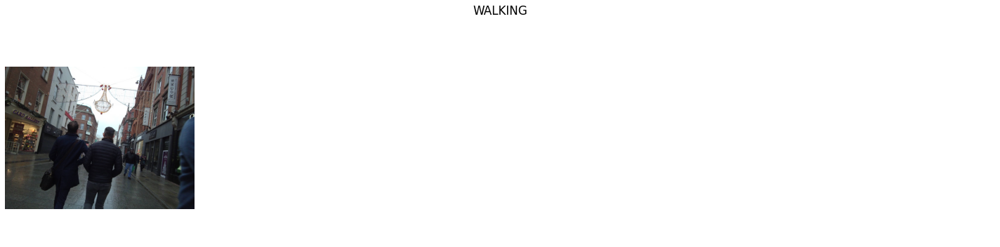

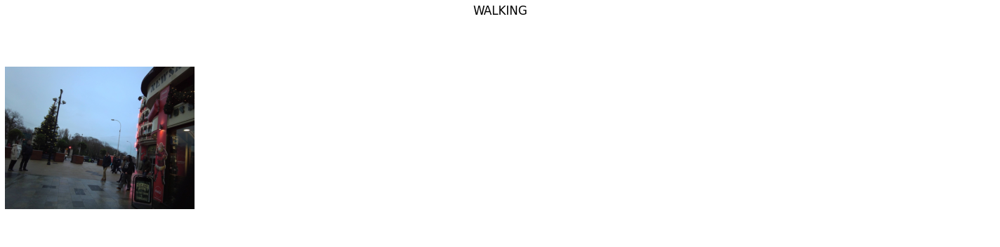

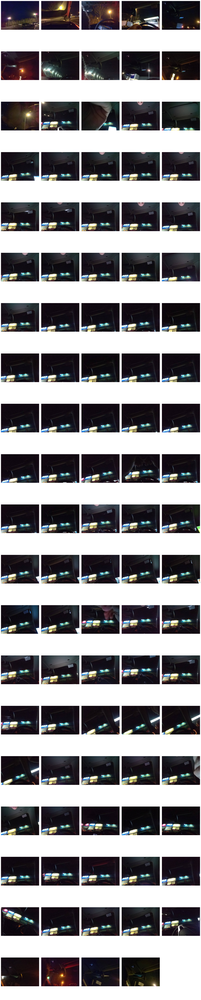

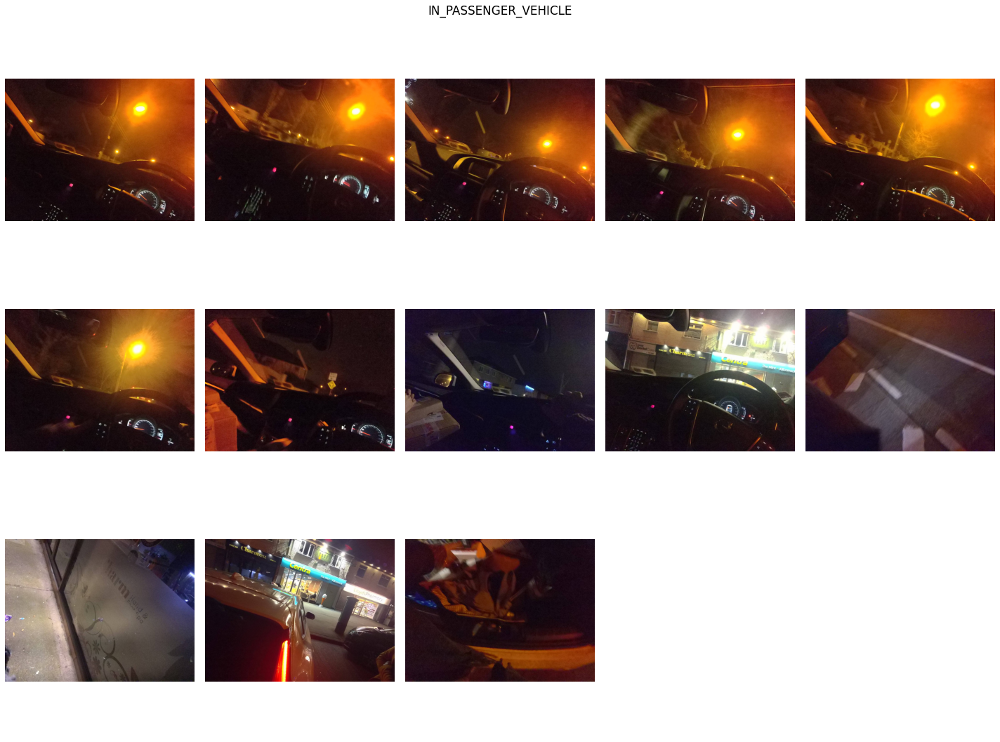

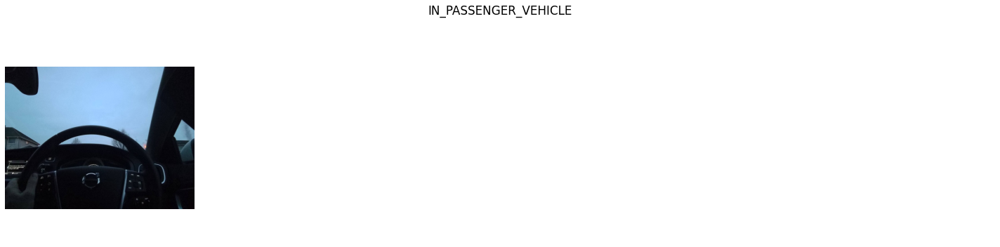

...

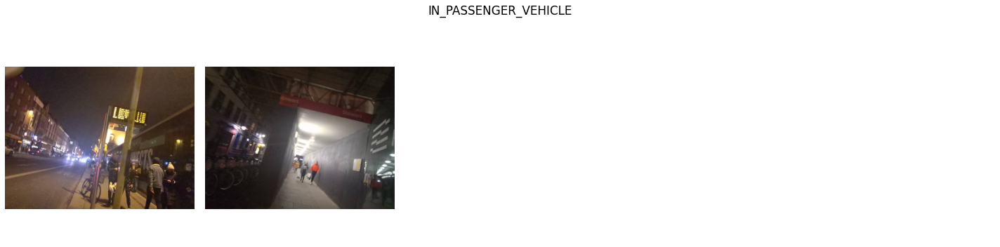

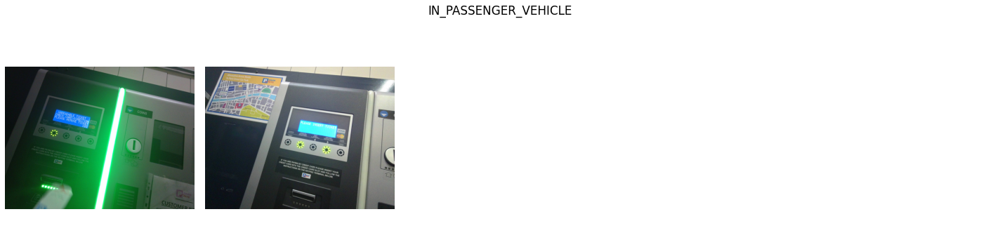

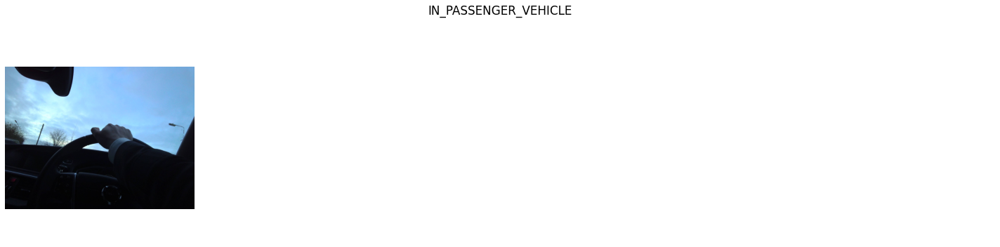

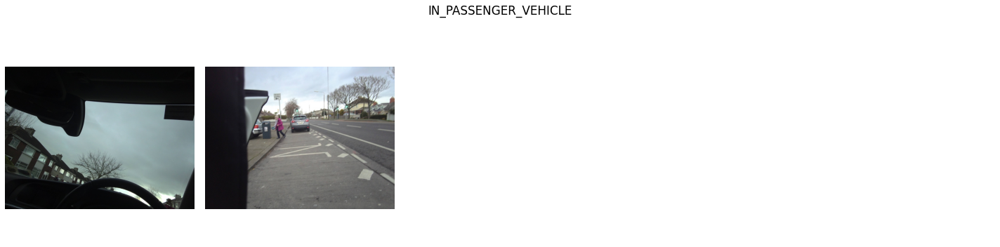

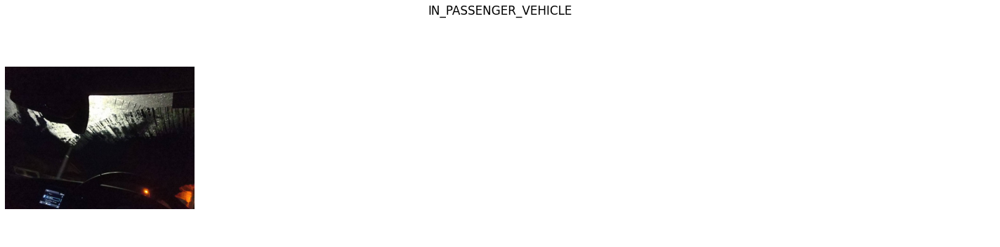

In [216]:
%matplotlib inline
for i in tqdm(range(len(wrong))):
    plot_images(json.loads(wrong.iloc[i]["images"].replace("\'", "\"")), wrong.iloc[i]["checkin"], savefile=i)